In [1]:
include("TontiDiagrams.jl")
using .Tonti
using CombinatorialSpaces
using DifferentialEquations
using Plots

┌ Info: Precompiling CombinatorialSpaces [b1c52339-7909-45ad-8b6a-6e388f7c67f2]
└ @ Base loading.jl:1278


## Define Tonti Diagrams
Initialize the tonti diagrams for the x and y dynamics (positions are now just attributes on the points of the simplex)

In [2]:
tdx = TontiDiagram(2, [:x =>:IP,  :vx =>:TP,  :Δx=>:IL,
                       :px=>:IS2, :∑fx=>:TS2, :fx=>:TL2]);
tdy = TontiDiagram(2, [:y=>:IP,   :vy =>:TP,  :Δy=>:IL,
                       :py=>:IS2, :∑fy=>:TS2, :fy=>:TL2]);

## Generate the complex

In [3]:
width = 30
height = 30
num_oscillators = width*height

s = OrientedDeltaSet2D{Bool}()
add_vertices!(s, num_oscillators)

ind(x,y) = x + (y-1)*(width)
tri_ind(x,y) = x + (y-1)*(width-1)*2

for y in 1:(height-1)
    for x in 1:(width-1)
        if y % 2 == 1
            glue_sorted_triangle!(s, ind(x,y), ind(x+1,y), ind(x,y+1), tri_orientation = false)
            glue_sorted_triangle!(s, ind(x+1,y+1), ind(x,y+1), ind(x+1,y), tri_orientation = true)
        else
            glue_sorted_triangle!(s, ind(x+1,y+1), ind(x,y+1), ind(x,y), tri_orientation = true)
            glue_sorted_triangle!(s, ind(x,y), ind(x+1,y+1), ind(x+1,y), tri_orientation = false)
        end
    end
end

addSpace!(tdx, s)
addSpace!(tdy, s)
addTime!(tdx)
addTime!(tdy)

## Add the physics

td = disj_union(tdx, tdy);

x0 = 1
k = 0.1
m = 1

unit(x) = x / sqrt(x[1]^2+x[2]^2)

addTransform!(td, [:Δx, :Δy], Δx->k*(x0*unit(Δx) - Δx), [:fx, :fy])
addTransform!(td, [:px], p->[p[1]/m], [:vx]);
addTransform!(td, [:py], p->[p[1]/m], [:vy]);

In [4]:
## Generate vectorfield

sim, data_syms = vectorfield(td, s)
data_syms

## 2D Harmonic system without viscosity

data_length = [data_syms[k][2] for k in keys(data_syms)]
du = zeros(sum(data_length))
u = [zeros(l) for l in data_length]

for y in 1:(height)
    for x in 1:(width)
        u[1][ind(x,y)] = x * x0 * 0.9
        u[3][ind(x,y)] = y * x0 * 0.9
    end
end

prob = ODEProblem(sim, vcat(u...), (0,1000.0))
sol = solve(prob);



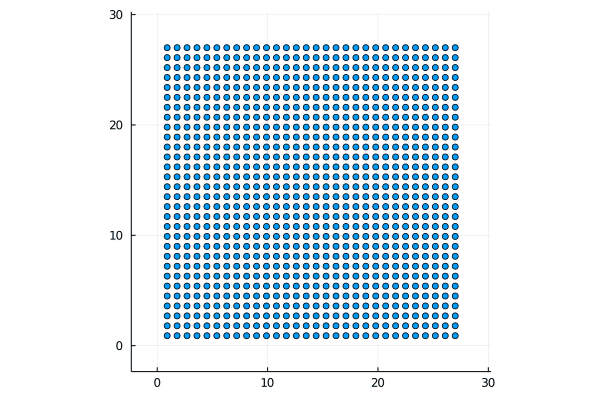

In [5]:

vals = sol(range(0, 100, length=200))
anim = @animate for loc ∈ vals
    plot(loc[1:data_syms[1][2]],loc[(1:data_syms[1][2]) .+ 2*data_syms[1][2]], legend=:none, seriestype = :scatter, ylims=[minimum(vals),maximum(vals)], xlims=[minimum(vals), maximum(vals)], ratio=1)
end
gif(anim, fps = 30)

In [6]:
## 2D Harmonic system with viscosity
visc = 0.02
addTransform!(td, [:vx], v->(-v*visc), [:∑fx]);
addTransform!(td, [:vy], v->(-v*visc), [:∑fy]);

simv, data_lengthv = vectorfield(td, s)

probv = ODEProblem(simv, vcat(u...), (0,1000.0))
solv = solve(probv);

vals = solv(range(0, 1000, length=200))


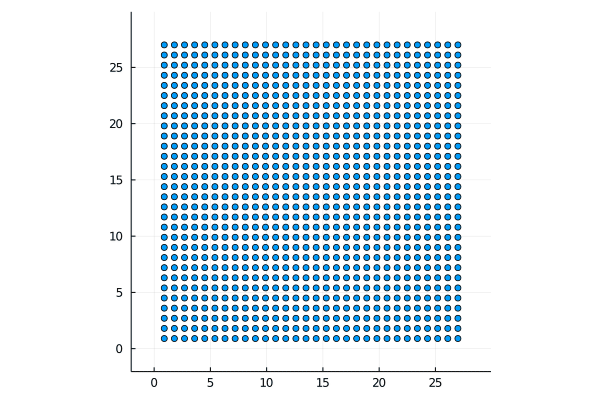

In [7]:
anim = @animate for loc ∈ vals
    plot(loc[1:data_syms[1][2]],loc[(1:data_syms[1][2]) .+ 2*data_syms[1][2]], legend=:none, seriestype = :scatter, ylims=[minimum(vals),maximum(vals)], xlims=[minimum(vals), maximum(vals)], ratio=1)
end
gif(anim, fps = 30)